In [13]:
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import re
import warnings
warnings.filterwarnings('ignore')

**Load Data**

In [14]:
train_df = pd.read_csv('datasets/train.csv')
test_df = pd.read_csv('datasets/test.csv')
print(train_df.shape, test_df.shape)

(146811, 3) (60427, 2)


**EDA**

In [15]:
train_df.head()

,review_id,review,rating
0,0,Ga disappointed neat products .. Meletot Hilsn...,1
1,1,"Rdtanya replace broken glass, broken chargernya",1
2,2,Nyesel bngt dsni shopping antecedent photo mes...,1
3,3,Sent a light blue suit goods ga want a refund,1
4,4,Pendants came with dents and scratches on its ...,1


In [16]:
test_df.head()

,review_id,review
0,1,"Great danger, cool, motif and cantik2 jg model..."
1,2,One of the shades don't fit well
2,3,Very comfortable
3,4,Fast delivery. Product expiry is on Dec 2022. ...
4,5,it's sooooo cute! i like playing with the glit...


**Check for duplicate reviews**

In [17]:
dup_df = train_df[train_df['review'].duplicated()]
print(f'No. of duplicate reviews on train data: {dup_df.shape[0]}')

No. of duplicate reviews on train data: 31483


**Check if the duplicate reviews have the same rating**

In [18]:
dup_df['check'] = dup_df.apply(lambda x: str(x.review) + str(x.rating), axis = 1)
print(dup_df['check'].duplicated().sum(),'of duplicate reviews have the same rating')

28523 of duplicate reviews have the same rating


**Since most of the duplicate reviews have the same rating, we could choose to drop them**

In [19]:
train_df.drop_duplicates(subset = 'review', inplace = True)

**Length statistics**

***The length will be needed to identify the amount of dimensions used for the model***

In [20]:
import nltk
nltk.download('punkt')
from nltk.tokenize import word_tokenize

def count_len(text):
    return len(word_tokenize(text))

[nltk_data] Downloading package punkt to /home/nvt/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [21]:
train_df['len'] = train_df['review'].apply(count_len)
test_df['len'] = test_df['review'].apply(count_len)

<Axes: >

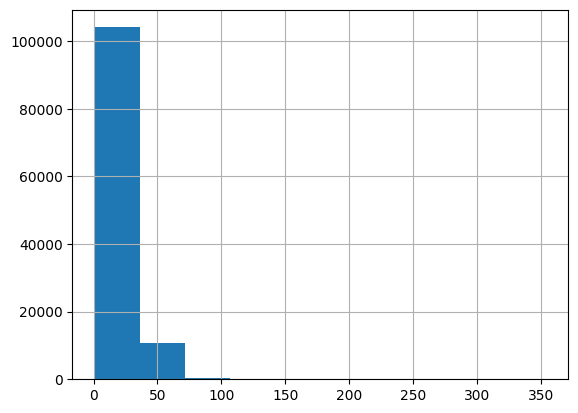

In [22]:
train_df['len'].hist()

<Axes: >

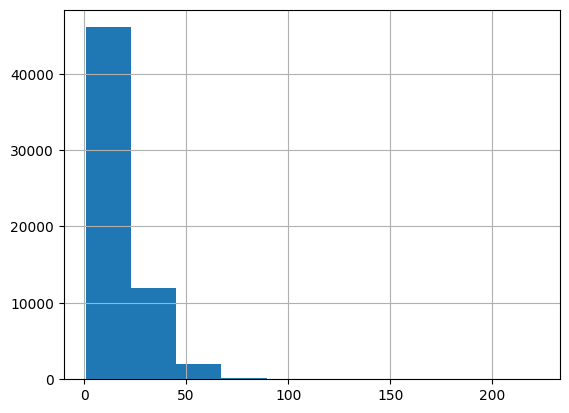

In [23]:
test_df['len'].hist()

**We could use MAX_LEN=100 as the number of dimensions for our model**

**Extend train data with publicly, freely available external data**

In [24]:
# kaggle.com/liuhh02/test-labelled
# old test leak labelled
test_labelled = pd.read_csv('datasets/test_labelled.csv')
test_labelled

,review_id,review,rating
0,0,slow delivery,1
1,1,Dateng goods do not conform pesanan😔,1
2,2,PSN k its 20 other DTG,1
3,3,I am expected that it have a frame and painted...,1
4,4,The product quality is not good.,1
...,...,...,...
62913,62913,Has shipped It was the model that fits the cut...,5
62914,62914,Awesome awesome speed of the ship's value CP,5
62915,62915,but already in lebihin one of its usual size w...,5
62916,62916,The product quality is excellent.,5


In [25]:
dup_testlab = test_labelled[test_labelled['review'].duplicated()]
print(f'No. of duplicate reviews: {dup_testlab.shape[0]}')
dup_testlab['check'] = dup_testlab.apply(lambda x: str(x.review) + str(x.rating), axis = 1)
print(dup_testlab['check'].duplicated().sum(),'of duplicate reviews have the same rating')

No. of duplicate reviews: 13040
11667 of duplicate reviews have the same rating


In [26]:
test_labelled.drop_duplicates(subset = 'review', inplace = True)

In [27]:
dup_testlab = test_labelled[test_labelled['review'].duplicated()]
print(f'No. of duplicate reviews: {dup_testlab.shape[0]}')

No. of duplicate reviews: 0


In [28]:
# kaggle.com/shymammoth/shopee-reviews
# scraped shopee reviews
scraped_reviews = pd.read_csv('datasets/shopee_reviews.csv')
scraped_reviews

,label,text
0,5,Looks ok. Not like so durable. Will hv to use ...
1,5,"Tried, the current can be very powerful depend..."
2,5,Item received after a week. Looks smaller than...
3,5,Thanks!!! Works as describe no complaints. Not...
4,5,Fast delivery considering it’s from overseas a...
...,...,...
1502570,5,Tried and it fit nicely will buy \nFast and go...
1502571,5,It's a fantastic product. Very reasonable pric...
1502572,5,Nice pair of shoes for a gd price. Note the cu...
1502573,1,Leather? Rubbish....moulded plastic. What a ...


*Change column names for merging*

In [29]:
scraped_reviews.rename(columns = {'text': 'review', 'label': 'rating'}, inplace = True)
scraped_reviews.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1502575 entries, 0 to 1502574
Data columns (total 2 columns):
 #   Column  Non-Null Count    Dtype 
---  ------  --------------    ----- 
 0   rating  1502575 non-null  object
 1   review  1502574 non-null  object
dtypes: object(2)
memory usage: 22.9+ MB


In [30]:
scraped_reviews['rating'].value_counts()

rating
5        1137695
5         166237
4          88686
3          42911
1          24704
2          16724
4          13443
3           6172
1           3650
2           2352
label          1
Name: count, dtype: int64

In [31]:
scraped_reviews = scraped_reviews[scraped_reviews['rating'] != 'label']
scraped_reviews['rating'] = scraped_reviews['rating'].astype(int)
scraped_reviews['rating'].value_counts()

rating
5    1303932
4     102129
3      49083
1      28354
2      19076
Name: count, dtype: int64

In [32]:
dup_scraped = scraped_reviews[scraped_reviews['review'].duplicated()]
print(f'No. of duplicate reviews: {dup_scraped.shape[0]}')

No. of duplicate reviews: 0


In [33]:
train_df = pd.concat([train_df, test_labelled], ignore_index=True)
train_df = pd.concat([train_df, scraped_reviews], ignore_index=True)
train_df = train_df.sample(frac=1).reset_index(drop=True)

**Final check for duplicates**

In [34]:
dup_train = train_df[train_df['review'].duplicated()]
print(f'No. of duplicate reviews on train data: {dup_train.shape[0]}')
dup_train['check'] = dup_train.apply(lambda x: str(x.review) + str(x.rating), axis = 1)
print(dup_train['check'].duplicated().sum(),'of duplicate reviews have the same rating')

No. of duplicate reviews on train data: 33166
191 of duplicate reviews have the same rating


In [35]:
train_df

,review_id,review,rating,len
0,NaN,Fast delivery. Quality not bad.,5,NaN
1,NaN,Finally received it in good condition. Great q...,5,NaN
2,NaN,Fast and great service,5,NaN
3,NaN,Received within days via post\nNo postage \nEx...,5,NaN
4,NaN,Very prompt delivery. Faster than as stated. A...,5,NaN
...,...,...,...,...
1667775,NaN,"Super fast delivery, they send it like less th...",5,NaN
1667776,NaN,Very fast delivery! Received the very next day...,5,NaN
1667777,NaN,Product is as seen picture looks nice 👍,5,NaN
1667778,NaN,Item received with packaging in immaculate con...,5,NaN


# Data Cleaning

In [36]:
train_df['rating'].value_counts()

rating
5    1347428
4     147498
3      89644
1      48145
2      35065
Name: count, dtype: int64

**Trim train set by half to minimize training time**

In [37]:
train_df = train_df.drop(train_df[train_df['rating'] == 5].sample(frac = .6).index)
print(train_df['rating'].value_counts())
print(train_df.shape)

rating
5    538971
4    147498
3     89644
1     48145
2     35065
Name: count, dtype: int64
(859323, 4)


**Join train and test for cleaning**

In [38]:
# adding column 'rating' to test dataset
test_df['rating'] = -1 # flag to separate train and test

# joining train and test datasets
reviews = pd.concat([train_df, test_df], ignore_index = True)
reviews

,review_id,review,rating,len
0,NaN,To small the toy,3,NaN
1,8213.0,"222 g ,, sent reply sent 227😣🤧",1,8.0
2,NaN,Overall it is quite good to use. But i got the...,3,NaN
3,NaN,Received with love. Thank you seller.,5,NaN
4,80194.0,Goods received. Package updates. Speed ​​trans...,4,19.0
...,...,...,...,...
919745,60423.0,Product has been succesfully ordered and shipp...,-1,27.0
919746,60424.0,Opening time a little scared. Fear dalemnya de...,-1,18.0
919747,60425.0,The product quality is excellent. The origina...,-1,34.0
919748,60426.0,They 're holding up REALLY well also .,-1,8.0


**Replace emoji with text**

In [39]:
import emoji  

have_emoji_train_idx = []

for idx, review in enumerate(reviews['review']):
    if any(char in emoji.EMOJI_DATA for char in review):
        have_emoji_train_idx.append(idx)

In [40]:
def emoji_cleaning(text):
    
    # change emoji to text
    text = emoji.demojize(text).replace(":", " ")
    
    # delete repeated emoji
    tokenizer = text.split()
    repeated_list = []
    
    for word in tokenizer:
        if word not in repeated_list:
            repeated_list.append(word)
    
    text = ' '.join(text for text in repeated_list)
    text = text.replace("_", " ").replace("-", " ")
    return text

In [41]:
reviews.loc[have_emoji_train_idx, 'review'] = reviews.loc[have_emoji_train_idx, 'review'].apply(emoji_cleaning)

In [42]:
def review_cleaning(text):
    
    text = text.lower()
    text = re.sub(r'\n', '', text)
    
#     text = text.replace("n't", ' not')
    
    # change emoticon to text
    text = re.sub(r':\(', 'dislike', text)
    text = re.sub(r': \(\(', 'dislike', text)
    text = re.sub(r':, \(', 'dislike', text)
    text = re.sub(r':\)', 'smile', text)
    text = re.sub(r';\)', 'smile', text)
    text = re.sub(r':\)\)\)', 'smile', text)
    text = re.sub(r':\)\)\)\)\)\)', 'smile', text)
    text = re.sub(r'=\)\)\)\)', 'smile', text)
    
#     # delete punctuation
#     text = re.sub('[^a-z0-9 ]', ' ', text)
    
    tokenizer = text.split()
    
    return ' '.join([text for text in tokenizer])

In [43]:
reviews['review'] = reviews['review'].apply(review_cleaning)

**Remove repeated letters**

In [44]:
repeated_rows_train = []

for idx, review in enumerate(reviews['review']):
    if re.match(r'\w*(\w)\1+', review):
        repeated_rows_train.append(idx)

In [45]:
def delete_repeated_char(text):
    
    text = re.sub(r'(\w)\1{2,}', r'\1', text)
    
    return text

In [46]:
reviews.loc[repeated_rows_train, 'review'] = reviews.loc[repeated_rows_train, 'review'].apply(delete_repeated_char)

**Recover shortened words**

In [47]:
def recover_shortened_words(text):
    
    text = re.sub(r'\bapaa\b', 'apa', text)
    
    text = re.sub(r'\bbsk\b', 'besok', text)
    text = re.sub(r'\bbrngnya\b', 'barangnya', text)
    text = re.sub(r'\bbrp\b', 'berapa', text)
    text = re.sub(r'\bbgt\b', 'banget', text)
    text = re.sub(r'\bbngt\b', 'banget', text)
    text = re.sub(r'\bgini\b', 'begini', text)
    text = re.sub(r'\bbrg\b', 'barang', text)
    
    text = re.sub(r'\bdtg\b', 'datang', text)
    text = re.sub(r'\bd\b', 'di', text)
    text = re.sub(r'\bsdh\b', 'sudah', text)
    text = re.sub(r'\bdri\b', 'dari', text)
    text = re.sub(r'\bdsni\b', 'disini', text)
    
    text = re.sub(r'\bgk\b', 'gak', text)
    
    text = re.sub(r'\bhrs\b', 'harus', text)
    
    text = re.sub(r'\bjd\b', 'jadi', text)
    text = re.sub(r'\bjg\b', 'juga', text)
    text = re.sub(r'\bjgn\b', 'jangan', text)
    
    text = re.sub(r'\blg\b', 'lagi', text)
    text = re.sub(r'\blgi\b', 'lagi', text)
    text = re.sub(r'\blbh\b', 'lebih', text)
    text = re.sub(r'\blbih\b', 'lebih', text)
    
    text = re.sub(r'\bmksh\b', 'makasih', text)
    text = re.sub(r'\bmna\b', 'mana', text)
    
    text = re.sub(r'\borg\b', 'orang', text)
    
    text = re.sub(r'\bpjg\b', 'panjang', text)
    
    text = re.sub(r'\bka\b', 'kakak', text)
    text = re.sub(r'\bkk\b', 'kakak', text)
    text = re.sub(r'\bklo\b', 'kalau', text)
    text = re.sub(r'\bkmrn\b', 'kemarin', text)
    text = re.sub(r'\bkmrin\b', 'kemarin', text)
    text = re.sub(r'\bknp\b', 'kenapa', text)
    text = re.sub(r'\bkcil\b', 'kecil', text)
    
    text = re.sub(r'\bgmn\b', 'gimana', text)
    text = re.sub(r'\bgmna\b', 'gimana', text)
    
    text = re.sub(r'\btp\b', 'tapi', text)
    text = re.sub(r'\btq\b', 'thanks', text)
    text = re.sub(r'\btks\b', 'thanks', text)
    text = re.sub(r'\btlg\b', 'tolong', text)
    text = re.sub(r'\bgk\b', 'tidak', text)
    text = re.sub(r'\bgak\b', 'tidak', text)
    text = re.sub(r'\bgpp\b', 'tidak apa apa', text)
    text = re.sub(r'\bgapapa\b', 'tidak apa apa', text)
    text = re.sub(r'\bga\b', 'tidak', text)
    text = re.sub(r'\btgl\b', 'tanggal', text)
    text = re.sub(r'\btggl\b', 'tanggal', text)
    text = re.sub(r'\bgamau\b', 'tidak mau', text)
    
    text = re.sub(r'\bsy\b', 'saya', text)
    text = re.sub(r'\bsis\b', 'sister', text)
    text = re.sub(r'\bsdgkan\b', 'sedangkan', text)
    text = re.sub(r'\bmdh2n\b', 'semoga', text)
    text = re.sub(r'\bsmoga\b', 'semoga', text)
    text = re.sub(r'\bsmpai\b', 'sampai', text)
    text = re.sub(r'\bnympe\b', 'sampai', text)
    text = re.sub(r'\bdah\b', 'sudah', text)
    
    text = re.sub(r'\bberkali2\b', 'repeated', text)
    
    text = re.sub(r'\byg\b', 'yang', text)
    
    return text

In [48]:
%%time
reviews['review'] = reviews['review'].apply(recover_shortened_words)

CPU times: user 1min 53s, sys: 41.8 ms, total: 1min 53s
Wall time: 1min 54s


**Lemmatization**

In [49]:
from nltk.stem import WordNetLemmatizer
from string import punctuation

lemma = WordNetLemmatizer()

In [50]:
!unzip -o /usr/share/nltk_data/corpora/wordnet.zip -d /usr/share/nltk_data/corpora/

In [51]:
def clean_review(review_col):
    review_corpus=[]
    
    for i in range(0, len(review_col)):
        review_text = str(review_col[i])
        review_text = re.sub('[^a-zA-Z]', ' ', review_text)
        review_text = [lemma.lemmatize(w) for w in word_tokenize(str(review_text).lower())]
        review_text = ' '.join(review_text)
        
        review_corpus.append(review_text)
        
    return review_corpus

In [52]:
# cleaning round 2, lemmatization
nltk.download('wordnet')

reviews['review'] = clean_review(reviews['review'].values)
reviews

[nltk_data] Downloading package wordnet to /home/nvt/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


,review_id,review,rating,len
0,NaN,to small the toy,3,NaN
1,8213.0,g sent reply persevering face sneezing face,1,8.0
2,NaN,overall it is quite good to use but i got the ...,3,NaN
3,NaN,received with love thank you seller,5,NaN
4,80194.0,good received package update speed transmissio...,4,19.0
...,...,...,...,...
919745,60423.0,product ha been succesfully ordered and shippe...,-1,27.0
919746,60424.0,opening time a little scared fear dalemnya des...,-1,18.0
919747,60425.0,the product quality is excellent the original ...,-1,34.0
919748,60426.0,they re holding up really well also,-1,8.0


**Separating train and test sets**

In [53]:
train_df = reviews[reviews.rating != -1]
train_df.drop(['review_id'], axis = 1, inplace = True)
train_df.head()

,review,rating,len
0,to small the toy,3,NaN
1,g sent reply persevering face sneezing face,1,8.0
2,overall it is quite good to use but i got the ...,3,NaN
3,received with love thank you seller,5,NaN
4,good received package update speed transmissio...,4,19.0


In [54]:
test_df = reviews[reviews.rating == -1]
test_df.drop(['rating'], axis = 1, inplace = True)
test_df['review_id'] = test_df['review_id'].astype(int)
test_df.head()

,review_id,review,len
859323,1,great danger cool motif and cantik juga model ...,27.0
859324,2,one of the shade don t fit well,8.0
859325,3,very comfortable,2.0
859326,4,fast delivery product expiry is on dec product...,20.0
859327,5,it s sooooo cute i like playing with the glitt...,41.0


**Save to file: clean extended train and test data**

In [55]:
train_df[['review', 'rating']].to_csv('datasets/clean_extended_train.csv', index = False)
test_df[['review_id', 'review']].to_csv('datasets/clean_test_up.csv', index = False)

In [56]:
train_df

,review,rating,len
0,to small the toy,3,NaN
1,g sent reply persevering face sneezing face,1,8.0
2,overall it is quite good to use but i got the ...,3,NaN
3,received with love thank you seller,5,NaN
4,good received package update speed transmissio...,4,19.0
...,...,...,...
859318,abit chipped off at the corner thank you,5,NaN
859319,very long delivery,3,NaN
859320,product a received material is thin and i reco...,5,NaN
859321,super fast delivery they send it like le than ...,5,NaN


In [57]:
test_df

,review_id,review,len
859323,1,great danger cool motif and cantik juga model ...,27.0
859324,2,one of the shade don t fit well,8.0
859325,3,very comfortable,2.0
859326,4,fast delivery product expiry is on dec product...,20.0
859327,5,it s sooooo cute i like playing with the glitt...,41.0
...,...,...,...
919745,60423,product ha been succesfully ordered and shippe...,27.0
919746,60424,opening time a little scared fear dalemnya des...,18.0
919747,60425,the product quality is excellent the original ...,34.0
919748,60426,they re holding up really well also,8.0


# Preprocessing

## Tokenization

**Change range of rating from (1 to 5) to (0 to 4)**

In [58]:
# since keras takes 0 as the reference, our category should start from 0 not 1
rating_mapper_encode = {1: 0,
                        2: 1,
                        3: 2,
                        4: 3,
                        5: 4}

# convert back to original rating after prediction later
rating_mapper_decode = {0: 1,
                        1: 2,
                        2: 3,
                        3: 4,
                        4: 5}

train_df['rating'] = train_df['rating'].map(rating_mapper_encode)

In [59]:
from keras.utils import to_categorical

# convert to one-hot-encoding-labels
train_labels = to_categorical(train_df['rating'], num_classes=5)

2023-06-12 03:31:23.595156: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-06-12 03:31:24.096157: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-06-12 03:31:24.102617: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-06-12 03:31:26.467937: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [60]:
from sklearn.model_selection import train_test_split

X_train, X_val, y_train, y_val = train_test_split(train_df['review'],
                                                  train_labels,
                                                  stratify=train_labels,
                                                  test_size=0.1,
                                                  random_state=1111)

X_train.shape, X_val.shape, y_train.shape, y_val.shape

((773390,), (85933,), (773390, 5), (85933, 5))

**Transform reviews into tokens**

In [61]:
# import package
from gensim.utils import tokenize

In [62]:
def tokenize_data(data_set):
    tokenized_set = []
    for doc in data_set:
        tokens = list(tokenize(doc, lowercase=True, deacc=True))
        tokenized_set.append(tokens)
    return tokenized_set

In [63]:
X_train = tokenize_data(X_train.values.tolist())
X_val = tokenize_data(X_val.values.tolist())
X_test = tokenize_data(test_df['review'].values.tolist())

In [64]:
len(X_train)

773390

In [65]:
len(X_val)

85933

In [66]:
len(X_test)

60427

## Vectorization

In [67]:
import gensim.downloader as api

glove = api.load('glove-twitter-100')

In [68]:
glove.most_similar('twitter')

[('facebook', 0.9003353714942932),
 ('fb', 0.8688419461250305),
 ('instagram', 0.8349379897117615),
 ('tweet', 0.8055214285850525),
 ('tweets', 0.7990750670433044),
 ('tumblr', 0.7980496287345886),
 ('tl', 0.7965695261955261),
 ('timeline', 0.7899292707443237),
 ('internet', 0.7715756893157959),
 ('twiter', 0.7672109007835388)]

In [69]:
def vectorize_words(word_list):
    vectors = []
    for word in word_list:
        try:
            vector = glove[word]
            vectors.append(vector)
        except KeyError:
            # If a word is not found in the GloVe embeddings, you can handle it here
            # For example, you can skip the word or assign a default vector
            pass
    return vectors

In [70]:
X_train_vec = [vectorize_words(words) for words in X_train]
X_val_vec = [vectorize_words(words) for words in X_val]
X_test_vec = [vectorize_words(words) for words in X_test]

In [76]:
X_train_vec

[[array([ 0.55257  , -0.015403 , -0.09453  ,  0.17899  , -0.10508  ,
          0.25689  ,  0.19223  , -0.38329  , -0.30272  , -0.26829  ,
         -0.73931  , -0.4905   , -4.5581   , -0.90362  ,  0.52713  ,
         -0.24139  ,  0.086399 , -0.40931  , -0.1263   , -0.082778 ,
          0.75381  , -0.029616 , -0.0098813,  0.02759  , -0.019953 ,
          0.3272   , -0.01042  ,  0.36987  ,  0.17661  , -0.17378  ,
         -0.058663 ,  0.11009  , -0.53504  ,  0.2629   ,  0.074181 ,
         -0.2537   ,  0.18366  , -0.12116  , -0.26975  , -0.15202  ,
         -0.94218  , -0.66184  ,  0.7366   ,  1.1287   ,  0.18825  ,
         -0.068786 ,  0.37668  , -0.090795 , -0.70532  ,  0.56786  ,
         -0.40073  ,  0.34645  , -0.20711  , -0.75144  ,  0.14923  ,
          0.59225  ,  0.15914  ,  0.016658 ,  0.94425  , -0.69536  ,
          0.095989 , -0.099311 ,  0.33105  , -0.11044  ,  0.71537  ,
          0.029107 , -0.37007  , -0.41564  , -0.40933  ,  0.34726  ,
         -0.19641  , -0.2227   , -

In [77]:
len(X_train_vec)

773390

In [74]:
len(X_val_vec)

85933

In [75]:
len(X_test_vec)

60427

# Build ANN Model